In [26]:
from IPython.display import HTML, display, Markdown, Latex
button = HTML('''<script>code_show=true; function code_toggle() {if (code_show){$('div.input').hide();} else {$('div.input').show();}code_show = !code_show} $( document ).ready(code_toggle);</script><form action="javascript:code_toggle()"><input type="submit" value="Toggle source code"></form>''')
display(Markdown('# Clik on the button below to show / hide the source code.'))
display(button)

# Clik on the button below to show / hide the source code.

### Part 1 <br><br> [Dataset exploration](#datasetexploration)
- [Description](#datasetdesc)
- [Columns correlation](#columnscorr)
- [Box plot representation](#boxplot)
- [Standardization](#standardization)

### Part 2 <br><br> [Unsupervised techniques](#unsupervised)
- [Principal Components Analysis](#pca)
- [Clustering and outlier analysis](#outliers)

### Part 3 <br><br> [Classification](#classification)
- [Defining the target](#target)
- [Cross validation](#cv)
- [Diagnosing bias and variance](#learncurves)
- [Evaluation metrics](#classmetrics)
- [K nearest neighbors](#knn)
- [SVC](#svc)
- [Random Forest for classification](#rfc)
- [Models comparison](#mc)

### Part 4 <br><br> [Regression](#regression)
- [Defining the target](#targetregr)
- [Linear regression](#linear-regression)
- [SVR](#svr)
- [Random Forest for regression](#rfregressor)
- [Models comparison](#mcr)

In [2]:
import numpy as np
import pandas as pd
import os
import seaborn as sns
import plotly
from ipywidgets import widgets
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import plotly.figure_factory as ff
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import learning_curve
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import roc_auc_score
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.model_selection import cross_val_score
from IPython.display import display_html
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.pipeline import Pipeline
from sklearn.model_selection import validation_curve
from sklearn import metrics
from sklearn.decomposition import PCA
from sklearn.svm import SVR
from sklearn.metrics import r2_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn import metrics
from sklearn.model_selection import validation_curve
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from IPython.display import HTML, display, Markdown, Latex, Image

init_notebook_mode(connected=True)
plotly.offline.init_notebook_mode()


colors = plotly.colors.DEFAULT_PLOTLY_COLORS
os.chdir(r'C:\Users\Raffaele\Desktop')
red_dataset = pd.read_csv('winequality-red.csv', sep=';')
white_dataset = pd.read_csv('winequality-white.csv', sep=';')
dataset = pd.concat([red_dataset, white_dataset]).reset_index(drop=True)
features = list(dataset.columns[0:len(dataset.columns)-1])

## Part 1<br><br>Dataset exploration <a name="datasetexploration"></a>
<br>
### Description <a name="datasetdesc"></a>

The dataset can be downloaded at http://archive.ics.uci.edu/ml/datasets/Wine+Quality. It is made of two files:
- winequality-white.csv
- winequality-red.csv

For the analysis, I will use the content of both the files, for a total of 6497 istances.

List of the columns:

- fixed acidity
- volatile acidity
- citric acid
- residual sugar
- chlorides
- free sulfur dioxide
- total sulfur dioxide
- density
- pH
- sulphates
- alcohol
- quality

All the columns contain continuos values, except the 'quality' column that contains discrete features. There are no missing values. I will define later which columns represent the features and which one is the target of our classification and regression tasks.

<br>

### Columns correlation <a name="columnscorr"></a>

The first insteresting thing to do is checking if the columns of the dataset contain some kind of relationships. This is useful because I am insterested in using only the features that would contribute most to the quality of the model, and features that have strong linear dependency can cause overfitting problems and reduce the performances. If I find out that there is a subset of features that are linear dependent, Ic oould consider to apply feature selection techniques or dimensionality reduction.

##### Correlation matrix
It is a symmetrical matrix that shows the Pearson correlation coefficient between the variables. The coefficient has a value between +1 and −1, where 1 represents positive correlation (e.g. when a feature increases, the other increases as well), 0 is no correlation, and −1 represents negative correlation.

The formula of the correlation index is given by:

$ ρ_{X,Y} = \frac{cov(X,Y)}{σ_{x}σ_{y}} $ 

where cov(X,Y) is the covariance between X and Y and σ is the standard deviation. Remember that $ cov(X,Y) = E[(X-E[X])(Y-E[Y])] $

##### Pairwise relationships on the scatter plot

It is also possible to see graphically, on a 2D plot, the relationship between each couple of columns. For this purpose, there is an interactive plot with two buttons to select the columns to be displayed.

In [3]:
corr = dataset.corr()
fig = ff.create_annotated_heatmap(
    z=np.around(corr.values.tolist(), 2), 
    x=list(corr.columns), 
    y=list(corr.columns), 
    colorscale=[[0,colors[0]], [0.5, 'white'], [1,colors[3]]], showscale=True
)
fig.layout.title='<b>Correlation matrix'
fig.layout.width=950
fig.layout.height=400
fig.data[0].update(zmin=-1, zmax=1)
fig.layout.xaxis.side = 'bottom'
fig.layout.margin = dict(b=0, l=250, r=250, t=60)
fig.layout.title.x = 0.5
fig.show()

In [4]:
f_default = dataset.columns[0]
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=dataset[f_default], y=dataset[f_default],
    mode='markers', 
    marker=dict(line=dict(color='black', width=0.2),size=3, color=colors[1]), 
))
fig.layout.xaxis.title = f_default
fig.layout.yaxis.title = f_default
fig.layout.xaxis.range = [min(dataset[f_default]),max(dataset[f_default])]
fig.layout.yaxis.range = [min(dataset[f_default]),max(dataset[f_default])]
x_buttons = []
y_buttons = []
for f in dataset.columns:
    b = dict(
        args=[
            {'x':[dataset[f]]}, 
            {
                'xaxis.title':f, 
                'xaxis.range':[min(dataset[f]), max(dataset[f])]
            }],
        label=f,
        method="update"
    )
    x_buttons.append(b)
    b = dict(
        args=[{'y':[dataset[f]]}, 
              {
                  'yaxis.title':f, 
                  'yaxis.range':[min(dataset[f]), max(dataset[f])]
              }],
        label=f,
        method="update"
    )
    y_buttons.append(b)
x_pos = 0.5
y_pos = 1
pad_scatter_dropdwns = 0.08
fig.layout.xaxis.domain = [0, x_pos]
fig.update_layout(
    updatemenus = [
        dict(
            buttons=x_buttons,
            showactive=True,
            x=x_pos+pad_scatter_dropdwns,
            xanchor="left",
            y=y_pos-0.08,
            yanchor="top",
        ), 
        dict(
            buttons=y_buttons,
            direction="down",
            showactive=True,
            x=x_pos+pad_scatter_dropdwns+0.2,
            xanchor="left",
            y=y_pos-0.08,
            yanchor="top"
        ), 
    ]
)
fig.update_layout(
    annotations=[
        dict(
            text="<b>X-Axis", 
            font=dict(size=14),
            xref="paper", yref="paper",
            x=x_pos+pad_scatter_dropdwns+0.03, y=y_pos, 
            showarrow=False
        ),
        dict(
            text="<b>Y-Axis", 
            font=dict(size=14),
            xref="paper", yref="paper",
            x=x_pos+pad_scatter_dropdwns+0.03+0.23, y=y_pos, 
            showarrow=False
        ),
    ])
fig.layout.title='<b>Pairwise relationships'
fig.layout.showlegend=False
fig.layout.height=350
fig.layout.width=950
fig.layout.margin=dict(t=40, b=0, l=0, r=0)
fig.layout.title.x = 0.172
fig.show()

From this representation I notice that any of the columns is strongly dependent from another, because the values are never greater than 0.8 or less than -0.8. 

The most correlated columns are 'total_solfure_dioxide' and 'free_sulfur_dioxide', positively correlated with ρ=0.72, and 'alchool' and 'density', negatively correlated with ρ=-0.69. If I display them on the scatter it's possible to see a kind of line that shows this correlation : in the first case (positive correlation) the 'line' has positive slope, in the second case (negative correlation) it has a negative slope. Instead, if I try to display 'density' and 'total_sulfur_dioxide' (ρ=0.03) I observe that the points on the scatter do not follow any relationship. When displaying the same feature (ρ=1) on both the axis, I see a diagonal.

### Box plot representation <a name="boxplot"></a>
<br>
Let's visualize the distributions of the columns through the box plot representation.

> ##### Box plots explained

> A box plot aims to visualize data through their quartiles (quartiles are the three cut points that will divide a dataset into four equal-sized groups). It shows the following statistics:

> - median (point that divide the data in two equal parts)
> - Q1 (first quartile) and Q3 (third quartile). The interquartile range IQR is defined as Q3-Q1 and contains 50% of the data.
> - the lower fence (Q1 - 1.5 IQR) and the upper fence (Q3 + 1.5 IQR)
> - the maximum and the minimum value

> The points in [minimum value, lower fence] and the points in [upper fence, maximum value] are represented with dots.

In [5]:
fig = go.Figure()
for i, feat in enumerate(dataset.columns):
    fig.add_trace(go.Box(
        y=dataset[feat], 
        name=feat, 
        line=dict(width=1),
        marker=dict(color=colors[i%len(colors)], size=3.5), 
        showlegend=False))
fig.update_layout(height=300, width=950, legend=dict(title='Features'))
fig.layout.margin = dict(t=30, b=30)
fig.layout.title = 'Original dataset'
fig.layout.title.x = .5
fig.show()

Looking at the box plot, at first glance I notice that the range of values is very different for each variable. To overcome this problem, I will standardize the dataset.
### Standardization <a name="standardization"></a>

It is a preprocessing technique that changes the values of the columns to a common scale, without distorting differences in the ranges of values.

> ##### Standardization explained
> It means rescales data to have a mean of 0 and a standard deviation of 1 (unit variance).

> The new value of x is calculated as: 

> $ z = \frac{x−μ}{σ} $

> where μ is the mean and σ is the standard deviation of the values of the variable.

Seeing the box plots after the standardization, I observe that now all the features are on the same scale. Notice that the 'quality' column is not standardized because it will be our target for classification.

Also, I observe that there are points that are clearly outliers. I will try to detect them later.

In [6]:
fig = go.Figure()
scaler = StandardScaler()
scaled_dataset = pd.DataFrame(scaler.fit_transform(dataset[features]), columns = features)
scaled_dataset['quality'] = dataset['quality']
for i, feat in enumerate(dataset.columns):
    fig.add_trace(go.Box(
        y=scaled_dataset[feat], 
        name=feat,
        line=dict(width=1),
        marker=dict(color=colors[i%len(colors)], size=3.5), 
        showlegend=False))
fig.update_layout(height=300, width=950, legend=dict(title='Features'))
fig.layout.title = 'After standardization'
fig.layout.title.x = .5
fig.layout.margin = dict(t=70, b=30)
fig.show()
# From now we will use the standardized dataset
raw_dataset = dataset
dataset = scaled_dataset

## Part 2<br><br>Unsupervised techniques <a name="unsupervised"></a>
<br>
### Principal Component Analysis <a name="pca"></a>

Principal Components Analysis (PCA) is a technique of dimensionality reduction. It can be useful for different purposes, such as data visualization of the entire dataset. We would like to find a low-dimensional representation of the data that captures as much of the information as possible: in that way it's possible to plot the dataset on a 3D space and understand if there is something interesting. Also, PCA could be useful when dealing with a big number or highly dependent features: it allows to work in a low-dimensional subspace, simplifying the model and reducing overfitting.

The idea is then to project the data in a lower dimensional subspace, while preserving as much infomration as possible. In particular, choose projection that minimizes the squared error in reconstruncting the original data.

> ##### Algorithm explained
There are different algorithms to perform PCA (sequencial, covariance matrix, SVD), we will use the one based on the covariance matrix. These are the step to follow:

> - Standardize the dataset<br><br>
> - Consider the covariance matrix:  

> $ XX^T = \frac{1}{m}\sum_{i}^m(X_{i}-\bar{X})(X_{i}-\bar{X})^T $

> where $ \bar{X} = \frac{1}{m}\sum_{i}^mX_{i} $

> - Compute the eigenvectors with related eigenvalues: {$ u_{i},λ_{i} $}



> - Sort the eigenvectors according to their eigenvalues in decreasing order. The first K eigenvectors correspond to the first K principal components.


> - Consider the W matrix, whose columns are the eigenvectors obtained in the previous step. The new subspace is given by:

> $ X_{t}=XW $

<br>

In the plots below there are the results of the PC analysis and the 3D representation. From the first plot I observe that each principal component brings a certain value of the explained variance: the first component represents the 25.8% of the variance, while the last one only the 0.3%. However, 11 principal components (almost all of them) are needed to reach the 99% of explained variance: this reflects the fact that the features are not highly correlated, as seen in the correlation matrix, and for this reason reducing the dimensionality of the dataset doesn't give a benefit in terms of semplification of the model.

Looking at the PCA representation I can see that the majority of the points lies in one portion of the 3D space, while few of them are very far from this zone: this means that they are outliers; this is in line from what I saw in the box plot representation.

In [7]:
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'xy'},{'type':'scene'}]], 
                    column_widths=[0.3, 0.7])

# Cumulative explained variance
explained_variance = []
for c in range(1, len(dataset.columns)+1):
    pca_dataset = PCA(n_components=c, random_state=0).fit(dataset)
    explained_variance.append(sum(pca_dataset.explained_variance_ratio_*100))
n_com = np.arange(1, len(dataset.columns)+1)
fig.add_trace(go.Scatter(
    x=n_com, y=explained_variance, 
    mode='markers+lines', 
    line=dict(shape='hv'), 
    showlegend=True,
    name='Cumulative'
), row=1, col=1)

# Single component variance
fig.add_trace(go.Bar(
    x=n_com, 
    y=pca_dataset.explained_variance_ratio_*100,
    name='Single component',
    showlegend=True
), row=1, col=1)
fig.update_layout(
    title='PCA Analysis', xaxis_title="n_components", yaxis_title="Explained variance (%)",
    height=300, width=500, 
    xaxis = dict(tickmode = 'linear',dtick=1, range=[0, len(features)+1])
)

pca = PCA(n_components=len(features), random_state=0)
pca_transformed = pca.fit_transform(dataset)
pca_df = pd.DataFrame()
for c in range(0, len(features)):
    pca_df[str(c+1)+'_comp'] = [row[c] for row in pca_transformed]

df = pca_df
fig.add_trace(go.Scatter3d(
        x=df['1_comp'], y=df['2_comp'], z=df['3_comp'],
        mode='markers', 
        marker=dict(color=colors[0], size=2, line=dict(color='darkblue', width=0.1)), 
        name='Dataset', showlegend=False
), row=1, col=2)

fig.layout.scene.xaxis = dict(range = [-8,10], title='1st PC')
fig.layout.scene.yaxis = dict(range = [-5,13.5], title='2nd PC')
fig.layout.scene.zaxis = dict(range = [-5,8], title='3rd PC')
fig.layout.yaxis.domain = [0.15,.85]
fig.layout.margin = dict(t=10)
fig.layout.legend.orientation = 'h'
fig.layout.legend.y = .0
fig.update_layout(height=450, title="", width=950, font_size=12, legend=dict(title='', font=dict(size=11)))
fig.show()

### Clustering and outlier analysis <a name="outliers"></a>
<br>
What to do with outliers? Should I discard them or not? There's not a general approach, it depends on their nature:

- If the outliers are due to wrong measuraments or errors in the extraction of the data, we should discard them.

- If the outliers are strange observations, but legitimate, it's wrong to discard them because we have to predict them as well with our model.

In this case, I will assume that the points that are very far from the center correspond to errors, so I would like to identify and drop them from the dataset. I built a simple outlier filter with the K-Means algorithm: it is a simple and elegant approach for partitioning a data set into K distinct, non-overlapping clusters.

> ##### K-means algorithm

> Consider a distance and a metric evaluation. In our case we will use Euclidean distance and the inertia: <br><br>

> Euclidean distance : $ d(p,q) = \sqrt{\sum{(p_i-q_i)^2}} $<br><br>
> The inertia is the sum of squared distances of samples to their cluster center : $ I = \sum{d(p_i, C_i)^2} $
<br><br>


> 0. Choose the number of cluster K.
<br><br>
> 1. Randomly assign a number, from 1 to K, to each of the observations. These serve as initial cluster assignments for the observations.
<br><br>
> 2. Iterate the following two steps until the cluster assignments in (b) stop changing: 

>>(a) For each of the K clusters, compute the cluster centroid. The kth cluster centroid is the mean of the observations in the kth cluster.

>>(b) Assign each observation to the cluster whose centroid is closest (where closest is defined using Euclidean distance).

> The K-means algorithm finds a local optimum: the results obtained will depend on the initial (random) cluster assignment of each observation in Step 1. For this reason, it is important to run the algorithm multiple times and select the best solution in terms of inertia.

To find the optimal value of K, the Elbow Method is used: considering the plot of the inertia depending on K, the optimal number of clusters is in corrispondence of an elbow (i.e. the point after which the distortion/inertia start decreasing in a linear fashion).

From the plot below on the left I observe that the optimal number is K=4. On the right the PCA representation of the clusters is shown, and I actually observe that points of the same cluster are very near between them.

In [8]:
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'xy'},{'type':'scene'}]], column_widths=[.45,.55], 
                    subplot_titles=['Elbow Plot', 'PCA representation of the clusters'])

# Elbow Plot
k_list = list(np.arange(1,14,1))
y = []
for k in k_list:
    kmeans = KMeans(n_clusters=k, n_init=10)
    kmeans.fit(dataset[features])
    y.append(kmeans.inertia_)
fig.add_trace(go.Scatter(x=k_list, y=y, showlegend=False), row=1, col=1)
fig.layout.xaxis.title='K'
fig.layout.xaxis.tickvals = k_list
fig.layout.yaxis.title='inertia'
# fig.layout.yaxis.domain = [.2,.8]

# Perform k-means with k=3
kmeans = KMeans(n_clusters=4, n_init=10)
kmeans.fit(dataset[features])
pca_centers = PCA(n_components=len(features), random_state=0).fit(dataset[features]).transform(kmeans.cluster_centers_)

# Detect outliers
threshold=14
distances_from_centroid = np.array([min(d) for d in kmeans.fit_transform(dataset[features])])
dataset['outlier'] = distances_from_centroid > threshold
pca_df['outlier'] = distances_from_centroid > threshold
n_outliers = len(dataset[dataset['outlier']==True])
#print('Number of outliers detected: '+str(n_outliers)+', '+str(n_outliers/dataset.shape[0])+' %')

# 3D plot of clusters
pca_df['cluster'] = kmeans.labels_
for i, c in enumerate(np.unique(pca_df['cluster'])):
    df = pca_df[(pca_df['cluster']==c)]
    fig.add_trace(go.Scatter3d(
        x=df['1_comp'], y=df['2_comp'], z=df['3_comp'], 
        mode='markers', 
        marker=dict(color=colors[i], size=2, line=dict(color='black', width=0.1)), 
        name='Cluster '+str(i)
    ), row=1, col=2)
fig.layout.scene.xaxis = dict(range = [-8,10], title='1st PC')
fig.layout.scene.yaxis = dict(range = [-5,13.5], title='2nd PC')
fig.layout.scene.zaxis = dict(range = [-5,8], title='3rd PC')

fig.layout.margin = dict(t=50, b=0)
fig.layout.height = 400
fig.layout.width = 950
fig.show()

To detect the outliers, the distance between the points and the nearest centroid (i.e. the centroid of its cluster) can be computed: the points whose distance is greater than a threshold level can be detected as outliers. In the left plot below the distribution of the distances are represented with a box-plot and a histogram representation. In that case the threshold level is set at 14. In the plot below on the right it's possible to visualize graphically the outliers and the distances from the centroids.

In [9]:
fig = make_subplots(
    rows=2, cols=2, 
    specs=[[{'type':'xy'},{'type':'scene', 'rowspan':2}],[{'type':'xy'},{}]], 
    subplot_titles=['Distribution of the distance between points and centroid', 'PCA representation of the outliers'],
    column_widths=[0.45,0.55],
)

# Display box plot
hist_data = [d for d in (distances_from_centroid)]
color_dist = colors[0]
fig.add_trace(go.Box(
    x=hist_data, 
    marker_color=color_dist, 
    line=dict(width=1), 
    marker=dict(size=2), name='',showlegend=False
), row=1, col=1)

# Display histogram
fig.add_trace(go.Histogram(
    x=hist_data, 
    marker_color=color_dist, 
    showlegend=False
), row=2, col=1)

# Display thresholds
fig.add_shape(go.layout.Shape(
    type="line", x0=threshold, y0=-0.5, x1=threshold, y1=0.5, 
    line=dict(color=colors[3], width=3), name=''
), row=1,col=1)
fig.add_shape(go.layout.Shape(
    type="line", x0=threshold, y0=0, x1=threshold, y1=350, 
    line=dict(color=colors[3], width=3), name=''
), row=2,col=1)
fig.add_annotation(go.layout.Annotation(
        x=threshold, y=0.2, text='Threshold='+str(threshold), 
        font=dict(size=11, color="white"), showarrow=False, 
        borderwidth=2, borderpad=4, 
        bgcolor=colors[3], width=80), row=1,col=1
)
fig.add_annotation(go.layout.Annotation(
        x=threshold, y=250, text='Threshold='+str(threshold), 
        font=dict(size=11, color="white"), showarrow=False, 
        borderwidth=2, borderpad=4, 
        bgcolor=colors[3], width=80), row=2,col=1
)

# Display normal points
df = pca_df[(pca_df['outlier']==False)]
fig.add_trace(go.Scatter3d(
        x=df['1_comp'], y=df['2_comp'], z=df['3_comp'], 
        mode='markers', 
        marker=dict(color=colors[7], size=2, line=dict(color='darkblue', width=0.1)), 
        name='Dataset',
        showlegend = True
), row=1, col=2)

# Display centroids
for i, c in enumerate(pca_centers):
    fig.add_trace(go.Scatter3d(
        x=[c[0]], y=[c[1]], z=[c[2]], mode='markers', showlegend=True,
        marker=dict(color=colors[i], size=5, line=dict(color='black',width=.1)), name='Centroid '+str(i)), row=1, col=2)

# Display outliers
df = pca_df[pca_df['outlier']==True]
display_legend = True
for i, row in df.iterrows():
    center = pca_centers[row['cluster']]
    fig.add_trace(go.Scatter3d(
        x=[center[0], row['1_comp']], 
        y=[center[1], row['2_comp']], 
        z=[center[2], row['3_comp']], 
        mode='markers+lines', 
        showlegend=display_legend, legendgroup='outliers', name='Outliers',
        marker=dict(color=colors[3], size=2, line=dict(color='black', width=0.5))
    ), row=1, col=2)
    display_legend = False

# Layout
fig.layout.xaxis.range = [0,25]
fig.layout.xaxis2.range = [0,25]
fig.layout.yaxis.domain = [0.5, 0.9]
fig.layout.yaxis2.domain = [0, 0.4]
fig.layout.scene.xaxis = dict(range = [-8,10], title='1st PC')
fig.layout.scene.yaxis = dict(range = [-5,13.5], title='2nd PC')
fig.layout.scene.zaxis = dict(range = [-5,8], title='3rd PC')
fig.layout.margin = dict(t=50, b=0)
fig.layout.height = 400
fig.layout.width = 950

fig.show()

# Removing the extreme outliers
dataset_with_outliers = dataset
raw_dataset = raw_dataset[dataset['outlier']==False]
dataset = dataset[dataset['outlier']==False]
pca_df = pca_df[pca_df['outlier']==False]

In [10]:
def display_side_by_side(dataframes):
    html_str=''
    for df in dataframes:
        html_str+=df.to_html()
    display_html(html_str.replace('table','table style="display:inline"'),raw=True)
    
def display_grid(grid):
    temp_dict = {}
    for i, v in grid.items():
        temp_dict[i] = [v]
    df = pd.DataFrame.from_dict(temp_dict).transpose()
    df.columns=['']
    df_rows = []
    for i,row in enumerate(df.iterrows()):
        df_rows.append(df[i:i+1])
    display_side_by_side(df_rows)
    
def show_learning_curve_confusion_matrix(clf, train, test, title=''):
    train_sizes = [.1, .325, .55, .775, 1]
    train_sizes, train_scores, val_scores = learning_curve(
        clf, train[features], train['classification_target'], scoring='accuracy',
        cv=3, n_jobs=-1, train_sizes=train_sizes, 
    )
    train_scores_mean = np.array([np.mean(score) for score in train_scores])
    train_scores_std = np.array([np.std(score) for score in train_scores])
    val_scores_mean = np.array([np.mean(score) for score in val_scores])
    val_scores_std = np.array([np.std(score) for score in val_scores])
    tn, fp, fn, tp = confusion_matrix(test['classification_target'], clf.predict(test[features])).ravel()
    fig = ff.create_annotated_heatmap(                   
        x=['False','True'],
        y=['True','False'],
        z=[[fp,tp],[tn,fn]],
        hoverongaps = False, showscale=True, colorscale=[[0, '#D98880'], [1.0, '#922B21']]
    )
    trace2 = go.Scatter(
        x=train_sizes, y=train_scores_mean,
        mode = 'lines',
        name='Train score', legendgroup='train',
        line=dict(color=colors[0]), xaxis='x2', yaxis='y2',
    )
    trace5=go.Scatter(
        x=train_sizes, y=val_scores_mean, 
        name='Cross validation score', legendgroup='val',
        line=dict(color='red'),
        fillcolor=colors[1],xaxis='x2', yaxis='y2',
        mode = 'lines',
    )
    fig.add_traces([trace2,trace5])
    # initialize xaxis2 and yaxis2
    fig['layout']['xaxis2'] = {}
    fig['layout']['yaxis2'] = {}
    # Edit layout for subplots
    fig.layout.xaxis2.update({'domain': [0, 0.6]})
    fig.layout.yaxis2.update({'domain': [.2,.9], 'range': [.65,1]})
    fig.layout.xaxis.update({'domain': [0.75, 1]})
    fig.layout.yaxis.update({'domain': [.15,.85]})
    # The graph's yaxis MUST BE anchored to the graph's xaxis
    fig.layout.yaxis2.update({'anchor': 'x2'})
    # Title of the axes
    fig.layout.xaxis2.update({'title': 'Number of training samples'})
    fig.layout.yaxis2.update({'title': 'Accuracy'})
    fig.layout.xaxis.update({'title': 'Target'})
    fig.layout.yaxis.update({'title': 'Prediction'})
    # Update the margins to add a title and see graph x-labels.
#     fig.layout.margin.update({'t':100, 'b':0})
#     fig.layout.update({'title': '<b>'+title+''})
    fig.layout.height=370
    fig.layout.width=950
    fig.layout.legend = dict(orientation='h')
    fig.layout.margin=dict(t=0)
    fig.show()

## Part 3<br><br>Classification <a name="classification"></a>

### Defining the target <a name="target"></a>

For the classification problem, let's predict the 'quality' attribute. For simplicity, I will consider the binary case: I label a wine as 'Good' if the quality is greater than 5, otherwise I label it as 'Bad'.


In [11]:
fig = make_subplots(rows=1, cols=2, column_widths=[0.65, 0.35])
x = dataset['quality'].value_counts().index.values
y = dataset['quality'].value_counts()
fig.add_trace(go.Bar(
    x=x, y=y, 
    marker=dict(color=colors[2:len(x)]), 
    showlegend=False
), row=1, col=1)
fig.layout.xaxis.title = 'Quality'
fig.layout.yaxis.title = 'Occurrencies'
fig.layout.xaxis.tickvals = [3,4,5,6,7,8,9]
dataset['classification_target'] = ['Good' if x<=5 else 'Bad' for x in dataset['quality']]
pca_df['classification_target'] = dataset['classification_target']
x = dataset['classification_target'].value_counts().index.values
y = dataset['classification_target'].value_counts()
fig.add_trace(go.Bar(
    x=x, y=y, 
    marker=dict(color=colors[0:2]), 
    showlegend=False
), row=1, col=2)
fig.update_layout(height=270, width=950, title='')
fig.layout.xaxis2.title = 'Classification target'
fig.layout.yaxis2.title = 'Occurrencies'
fig.layout.margin = dict(t=0)
fig.show()

train, test = train_test_split(dataset, test_size=0.35, random_state=0)

### Cross validation <a name="cv"></a>

To build the models with the various algorithms, I will follow the following schema:

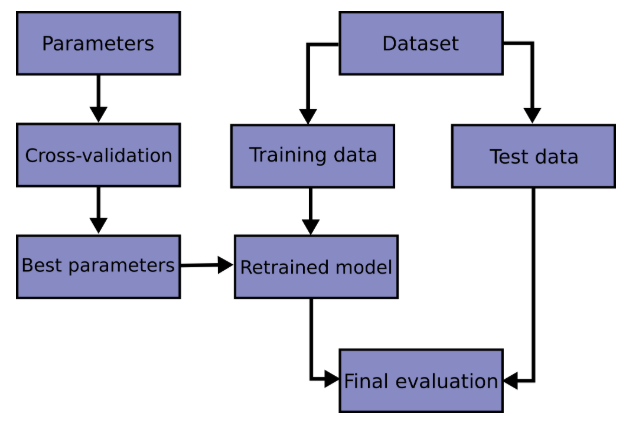

In [56]:
im = Image(filename='images/bestparams.png', width=350, height=200)
display(im)

The dataset is divided in training and test sets with a random split, in 65-35% proportions. Here is the schema of how cross validation works:

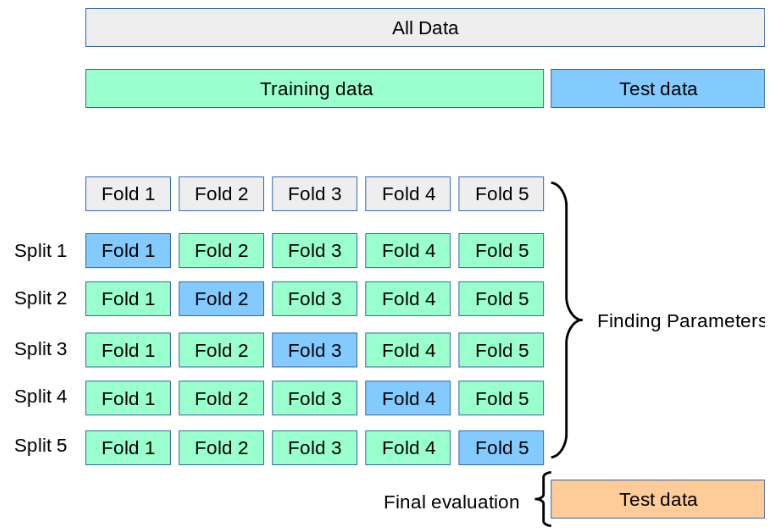

In [58]:
im = Image(filename='images/crossval.png', width=400, height=200)
display(im)

The training set is split into k smaller sets. At each iteration:

- A model is trained using k-1 folds as training data;

- the resulting model is validated on the remaining part of the data

The performance measure reported by k-fold cross-validation is then the average of the values computed in the loop. We will use K-Fold Cross-Validation with K=3.

### Diagnosing bias and variance <a name="learncurves"></a>

When building a model, we would keep the error as low as possible: the two major sources of error are bias and variance. If we managed to reduce these two, then we could build more accurate models. In practice, however, we need to accept a trade-off. We can’t have both low bias and low variance, so we want to aim for something in the middle.

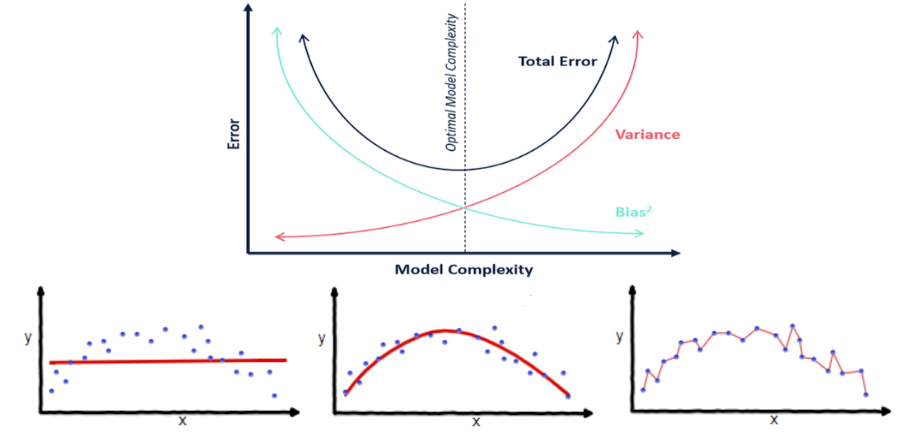

In [59]:
im = Image(filename='images/tradeoff.png', width=650, height=300)
display(im)

<br>
To diagnose if the the algorithm suffers from a bias or variance problem, I will display both the learning and validation curves:

<b>Learning curves</b>: they show the training and validation scores depending on the number of samples. In the ideal situation both the scores should converge at the same value (low variance) and that value should be good (low bias).

<b>Validation curves</b>: they show the training and validation scores depending on a specific parameter of the algorithm.
<br><br><br>
### Evaluation metrics <a name="classmetrics"></a>

For each algorithm I will evaluate the performances on the test with the following metrics:

- <b>Confusion Matrix</b>: each row of the matrix represents the instances in a predicted class while each column represents the instances in an actual class. We can then visualize the amount of TN (true negatives), FN (false negatives), FP (false positives), TP (true positives).


- <b>Accuracy</b>: $ \frac{(TN + TP)}{(TN+TP+FP+FN)} $


- <b>Precision</b>: $ \frac{TP}{TP+FP} $ It tells the proportion of positive predictions was actually correct.


- <b>Recall</b>: $ \frac{TP}{TP+FN} $ It tells what proportion of actual positives was correctly predicted.


- <b>F1</b>: $ 2*\frac{Precision*Recall}{Precision+Recall} $

<br><br>

### K-Nearest Neighbors <a name="knn"></a>
<br>
The first algorithm I will use is very simple and its training phase is considered "lazy", because it doesn’t learn a discriminative function from the training data but “memorizes” the training dataset instead.
<br><br>
#### Algorithm explained

> - Select the number of K
> - Given a new observation, compute the distances between the points of the dataset and the observation itself
> - Sort the distances and consider the points that have the K smallest distances
> - Get the labels of the selected K points
> - Classify the new observation with the mode of the labels (i.e. the label that appears most often)

#### Parameters of interest

> - <b>n_neighbors</b>: number of neighbors to use
<br><br>
> - <b>weights</b>: weight function used in prediction. 
<br>
    * Uniform weights: all the points are weighted equally. 
    * Distance weights: the inverse of the distance of the points is considered; in this case, closer neighbors will have a greater influence than neighbors which are further away.
<br><br>
> - <b>metric</b>: the distance metric to use. 
<br>
    * euclidean: $ d(p,q) = \sqrt{\sum{(p_i-q_i)^2}} $ 
    * manhattan: $ d(p,q) = \sum{\lvert{p_i-q_i}\rvert} $

In [12]:
param_grid = {
    'metric': ["manhattan", "euclidean"],
    'n_neighbors': [5,11,25,45,59]
}

clf = GridSearchCV(KNeighborsClassifier(), param_grid, scoring='accuracy', cv=3, n_jobs=-1)
clf.fit(train[features], train['classification_target'])

test['knn_pred'] = clf.predict(test[features])
test['knn_proba'] = clf.predict_proba(test[features])[:,1] # Probabilities related to 'Good' class

display(Markdown('###### Grid search'))
display_grid(param_grid)
display(Markdown('###### Best parameters'))
display_grid(clf.best_params_)

show_learning_curve_confusion_matrix(clf.best_estimator_, train, test)

###### Grid search

,
metric,"[manhattan, euclidean]"
,
n_neighbors,"[5, 11, 25, 45, 59]"


###### Best parameters

,
metric,euclidean
,
n_neighbors,45


Looking at the learning curves, I observe that the training and validation curves converge to the same value: it means that the model does not suffer from high variance. However, the score is about 0.75 and there is a lot of margin to improve: it could be that it suffers from a high bias problem, and with a more complex model (lower bias) I could likely obtain better results. Also I can state that adding more training samples will not likely improve the performances because the two curves have already converged.

In [13]:
k_values = [list(np.arange(5,110,10)), list(np.arange(115,300,20))]
k_values = [item for sublist in k_values for item in sublist]
train_scores = []
val_scores = []
for k in k_values:
    clf.best_estimator_.n_neighbors = k
    clf.best_estimator_.fit(train[features], train['classification_target']=='Good')
    train_score = accuracy_score(clf.best_estimator_.predict(train[features]), train['classification_target']=='Good')
    val_score = np.mean(cross_val_score(clf.best_estimator_, train[features], train['classification_target']=='Good', cv=3))
    train_scores.append(train_score)
    val_scores.append(val_score)
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=k_values,
    y=train_scores,
    name='Train score',
    marker=dict(color=colors[0]),
    mode = 'lines',
    showlegend=True
))
fig.add_trace(go.Scatter(
    x=k_values,
    y=val_scores,
    name='Cross validation score',
    line=dict(color='red'),
    mode = 'lines',
    showlegend=True
))
fig.layout.xaxis.title='K'
fig.layout.yaxis.title='Accuracy'
fig.layout.height=300
fig.layout.width=750
fig.layout.margin = dict(t=30, b=30)
fig.show()

It's shown from the validation plot that there is a clear situation of overfitting with small values of K. The best tradeoff is in corrispondence of K = 45, as expected from the cross-validation outcome.
<br><br><br><br>
### Support Vector Machine <a name="svc"></a>


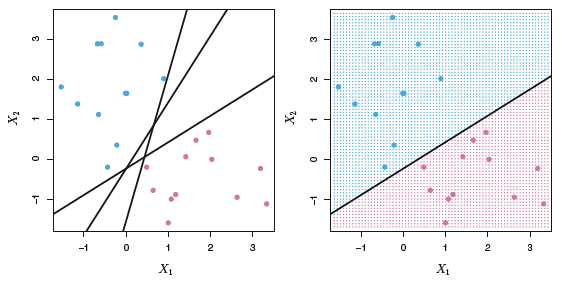

In [60]:
im = Image(filename='images/svm.png', width=400, height=300)
display(im)


The basic idea of the SVM classifier is to find the hyperplane that maximize the margin. The margin is defined as the shortest distance between the points and the decision boundary (hyperplane). The hyperplane in n-dimension has the following equation:

\begin{eqnarray}
f({\bf x})={\bf x}^T {\bf w}+b=\sum_{i=1}^n x_i w_i+b=0
\end{eqnarray}

that in 2-d space it corresponds to a line. 

#### Hard Margin SVM
Maximize the margin $ \frac{2}{||\bf w||} $ is equivalent to minimize the quantity $ {||{\bf w}||} $. The problem can be written as

\begin{eqnarray}
  & \mbox{minimize} & \frac{1}{2}||{\bf w}||^2 = \frac{1}{2}{\bf w}^T {\bf w}
  \;\;\;\;\;\;\   \nonumber \\
  & \mbox{subject to} & y_i ({\bf x}_i^T {\bf w}+b) \ge 1
  \nonumber
\end{eqnarray}

With hard margin SVM the solution will be very specific for the dataset, e.g. it will be overfitting. It is clear by looking at the plot below that adding an additional blue point leads to a dramatic shift of the optimal hyperplane.



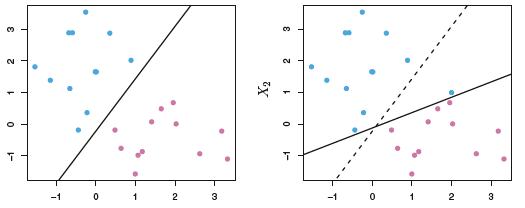

In [61]:
im = Image(filename='images/soft_margin.png', width=500, height=400)
display(im)


For this reason a slack variable it's introduced, such a way that way the algorithm is allowed to do misclassifications:

#### Soft Margin SVM

The equation become:

\begin{eqnarray}
&   \mbox{minimize} & \frac{1}{2}{\bf w}^T {\bf w}+C\sum_{i=1}^m \xi_i^k
    \nonumber \\
&   \mbox{subject to} & y_i ({\bf x}_i^T {\bf w}+b) \ge 1-\xi_i,
    \;\;\;\mbox{and}\;\;\;\xi_i \ge 0;\;\;\;
    \nonumber
\end{eqnarray}

So, we want to maximize the margin and minimize the amount of slack. 

#### How to solve the problem?

It is a constrained optimization problem that can be solved with Lagrange multipliers method. We end up with the dual problem:

\begin{eqnarray}
&   \mbox{maximize} & L_d({\bf \alpha})=
    \sum_{i=1}^m\alpha_i -\frac{1}{2}
    \sum_{i=1}^m \sum_{j=1}^m \alpha_i \alpha_j y_i y_j {\bf x}_i^T{\bf x}_j
    \nonumber \\
&   \mbox{subject to} & \alpha_i∈[0,C],\;\;\;\;
    \sum_{i=1}^m \alpha_i y_i=0 \nonumber
\end{eqnarray}

This problem is typically solved with Sequential Minimization Optimization algorithm (SMO). 

#### Kernel trick for non linear problems

Why is it convenient to write the problem in that way? Observe that $ \bf x $ appear only in the form of dot products in the formulation of the problem.



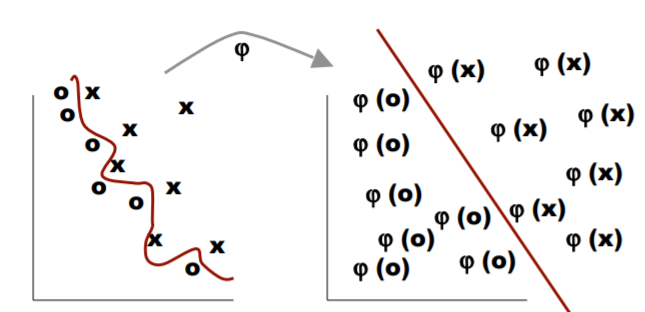

In [62]:
im = Image(filename='images/Kernel_Trick.png', width=400, height=400)
display(im)


If the problem is non-linear, we can map $ \bf x $ into a feature space of higher dimensions: $ \bf x⟶ϕ(x) $ in which the classes can be linearly separated. This results in a non-linear decision boundary in the original dimensions. As the vectors $ \bf x_i $ appear only in inner products, the mapping function $ \bfϕ(x) $ does not need to be explicitly specified; instead, we define a so-called kernel function as a function that takes two vectors as arguments and returns the value of the inner product of their projection in the new subspace:
\begin{eqnarray}
    \nonumber \\
&   & K({\bf x}_1,{\bf x}_2)=\phi({\bf x}_1)^T\phi({\bf x}_2)   
\end{eqnarray}

Some examples of kernels are:
- Linear: $ K({\bf x}_1,{\bf x}_2)=({\bf x}_1,{\bf x}_2)$
- rbf: $ K({\bf x}_1,{\bf x}_2)=exp(−γ(||{\bf x}_1−{\bf x}_2||^2)) $
<br><br>
#### Parameters of interest

> - <b>kernel</b>: Specifies the kernel type to be used in the algorithm. It must be one of ‘linear’, ‘poly’, ‘rbf’, ‘sigmoid’, ‘precomputed’ or a callable.
<br><br>
> - <b>C</b>: Regularization parameter that controls the trade-off between achieving a low error on the training data and minimising the norm of the weights.
<br><br>
> - <b>gamma</b>: Kernel coefficient for ‘rbf’, ‘poly’ and ‘sigmoid’. The higher the gamma value it tries to exactly fit the training data set.

In [14]:
param_grid = [
{
    'kernel': ['linear'],
    'C': [0.1, 1, 10],
}, 
{
    'kernel': ['rbf'],
    'C': [0.1, 1, 10],
    'gamma': [0.001, 0.01, 0.1, 1],
}]

clf = GridSearchCV(SVC(random_state=0, probability=True), param_grid, scoring='accuracy', cv=3, n_jobs=-1)
clf.fit(train[features], train['classification_target'])

test['svc_pred'] = clf.predict(test[features])
test['svc_proba'] = clf.predict_proba(test[features])[:,1]

display(Markdown('###### Grid search'))
display_grid(param_grid[0])
display_grid(param_grid[1])
display(Markdown('###### Best parameters'))
display_grid(clf.best_params_)
show_learning_curve_confusion_matrix(clf.best_estimator_, train, test)

###### Grid search

,
C,"[0.1, 1, 10]"
,
kernel,[linear]


,
C,"[0.1, 1, 10]"
,
gamma,"[0.001, 0.01, 0.1, 1]"
,
kernel,[rbf]


###### Best parameters

,
C,10
,
gamma,0.1
,
kernel,rbf


I observe that, compared to the previous algorithm, here there is more variance (the gap between the curves is larger) but also less bias (the scores are higher). The variance of the model could be likely reduced adding more training samples.

In [15]:
fig = make_subplots(rows=1, cols=2, shared_yaxes=True)

# Validation curve for gamma
params = np.logspace(-4, 2, 5)
train_scores, val_scores = validation_curve(
    clf.best_estimator_, 
    train[features], 
    train['classification_target'], 
    "gamma", 
    params, 
    cv=3,
    n_jobs=-1
)
fig.add_trace(go.Scatter(
    x=params,
    y=[np.mean(sc) for sc in train_scores],
    name='Train score',
    marker=dict(color=colors[0]),
    mode = 'lines',
    legendgroup='t',
    showlegend=True
),row=1,col=1)
fig.add_trace(go.Scatter(
    x=params,
    y=[np.mean(sc) for sc in val_scores],
    name='Cross validation score',
    line=dict(color='red'),
    legendgroup='v',
    mode = 'lines',
    showlegend=True
),row=1,col=1)
fig.layout.xaxis.title='gamma'
fig.layout.yaxis.title='Accuracy'
fig.layout.xaxis.type="log"

params = [.1, 1, 10, 100, 1000]
train_scores, val_scores = validation_curve(
    clf.best_estimator_, 
    train[features], 
    train['classification_target'], 
    "C", 
    params, 
    cv=3,
    n_jobs=-1
)
fig.add_trace(go.Scatter(
    x=params,
    y=[np.mean(sc) for sc in train_scores],
    name='Train score',
    marker=dict(color=colors[0]),
    legendgroup='t',
    mode = 'lines',
    showlegend=False
),row=1,col=2)
fig.add_trace(go.Scatter(
    x=params,
    y=[np.mean(sc) for sc in val_scores],
    name='Cross validation score',
    legendgroup='v',
    line=dict(color='red'),
    mode = 'lines',
    showlegend=False
),row=1,col=2)
fig.layout.xaxis2.title='C'
fig.layout.yaxis2.title=''
fig.layout.xaxis2.type="log"
fig.layout.xaxis2.tickvals = params

fig.layout.height=300
fig.layout.width=950

fig.layout.margin = dict(t=30, b=30)
fig.show()

At the beginning of both the plots (e.g. small values of the parameters) there is a situation of underfitting. Also I can clearly observe that in both plots there is a point where the model starts to overfit.

### Random Forest <a name="rfc"></a>
Random Forest is an ensemble method: it uses multiple models (called weak learners) to obtain better predictive performance than could be obtained from a single model. It could be used with any type of base algorithm but very often it is used with Decision Trees. 

It is a bagging technique: each base tree is grown using a bootstrap sample of the original training data. A bootstrap sample is basically a random sampling with replacement from the training data.



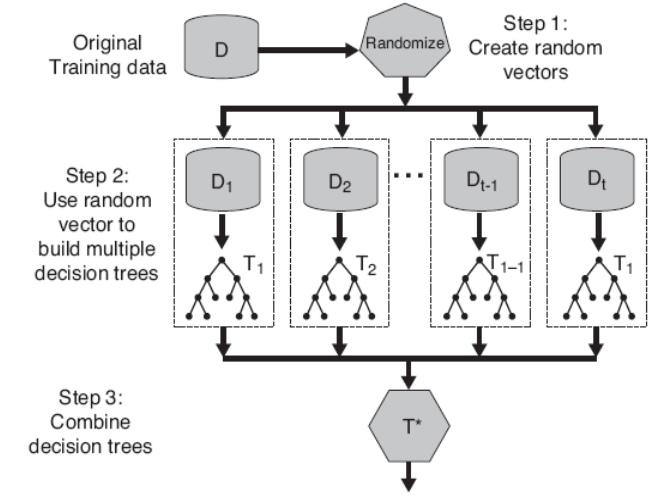

In [63]:
im = Image(filename='images/rf.png', width=400, height=400)
display(im)


In case of classification, the final prediction is the class that is the mode of the classes of the individual trees.

#### Parameters of interest

> - <b>n_estimators</b>: The number of weak learners, e.g. the number of trees in the forest.
<br><br>
> - <b>criterion</b>: The function to measure the quality of a split. It is intended for the selection of the best attribute on which the split will be performed. We will consider:
    * Gini index: $ Gini = 1-\sum{p_i^2} $
    * Entropy: $ E = \sum{-p_ilog_2p_i} $ , where p is the probability of an object being classified to a particular class.
<br><br>
> - <b>max_depth</b>: The maximum depth of the tree. Each tree growth will be stopped when reaching this depth: this parameter aims to reduce overfitting.
<br><br>
> - <b>max_features</b>: The number of features to consider when looking for the best split. This parameter aims to give more randomness to each single learner.

In [16]:
param_grid = {
    'criterion': ['gini', 'entropy'],
    'n_estimators': [5,15,50],
    'max_features': [1,2,3,4],
    'max_depth' : [3,5,10]
}

clf = GridSearchCV(RandomForestClassifier(random_state=0), param_grid, scoring='accuracy', cv=3, n_jobs=-1)
clf.fit(train[features], train['classification_target'])

test['random_forest_pred'] = clf.predict(test[features])
test['random_forest_proba'] = clf.predict_proba(test[features])[:,1] # Probabilities related to 'Good' class

display(Markdown('###### Grid search'))
display_grid(param_grid)
display(Markdown('###### Best parameters'))
display_grid(clf.best_params_)

show_learning_curve_confusion_matrix(clf.best_estimator_, train, test)

###### Grid search

,
criterion,"[gini, entropy]"
,
max_depth,"[3, 5, 10]"
,
max_features,"[1, 2, 3, 4]"
,
n_estimators,"[5, 15, 50]"


###### Best parameters

,
criterion,gini
,
max_depth,10
,
max_features,2
,
n_estimators,50


Adding more training samples will likely improve the performances, reducing the variance.

In [17]:
fig = make_subplots(rows=1, cols=2, subplot_titles=['Features importance',''], column_widths=[.45,.55])

# Features importance
fig.add_trace(go.Bar(
    x=features, 
    y=list(clf.best_estimator_.feature_importances_), 
    text=[round(y,3) for y in list(clf.best_estimator_.feature_importances_)], 
    textposition='auto',
    showlegend=False
), row=1,col=1)

# Validation curve for max_features
params = [1,2,3,4]
train_scores, val_scores = validation_curve(
    clf.best_estimator_, 
    train[features], 
    train['classification_target'], 
    "max_features", 
    params, 
    cv=3
) 
fig.add_trace(go.Scatter(
    x=params,
    y=[np.mean(sc) for sc in train_scores],
    name='Train score',
    marker=dict(color=colors[0]),
    mode = 'lines',
    showlegend=True
),row=1,col=2)
fig.add_trace(go.Scatter(
    x=params,
    y=[np.mean(sc) for sc in val_scores],
    name='Cross validation score',
    line=dict(color='red'),
    mode = 'lines',
    showlegend=True
),row=1,col=2)
fig.layout.legend=dict(orientation='h', x=0.6, y=0)
fig.layout.xaxis2.title='max_features'
fig.layout.yaxis2.title='Accuracy'
fig.layout.height=400
fig.layout.width=950
fig.layout.margin = dict(t=30, b=30)
fig.layout.yaxis.domain = [0, 0.9]
fig.layout.yaxis2.domain = [.2, .85]
fig.show()

I notice that the features that has more importance are those that are more correlated with the target (it can be checked it from the correlation matrix).

From the validation plots, I observe that max_features and max_depth make the model more complex. Also I notice that the higher the n_estimators parameter (number of weak learners), the higher is the training/validation score, but keep in mind that increasing that number, also the prediction time will be higher.

In [18]:
fig = make_subplots(rows=1, cols=2, subplot_titles=['',''], shared_yaxes=True)

# Validation curve for n_estimators
params = np.arange(5,70,5)
train_scores, val_scores = validation_curve(
    clf.best_estimator_, 
    train[features], 
    train['classification_target'], 
    "n_estimators", 
    params, 
    cv=3,
    n_jobs=-1
)
fig.add_trace(go.Scatter(
    x=params,
    y=[np.mean(sc) for sc in train_scores],
    name='Train score',
    marker=dict(color=colors[0]),
    mode = 'lines',
    showlegend=True
),row=1,col=1)
fig.add_trace(go.Scatter(
    x=params,
    y=[np.mean(sc) for sc in val_scores],
    name='Cross validation score',
    line=dict(color='red'),
    mode = 'lines',
    showlegend=True
),row=1,col=1)

# Validation curve for max_depth
params = np.arange(5,50,5)
train_scores, val_scores = validation_curve(
    clf.best_estimator_, 
    train[features], 
    train['classification_target'], 
    "max_depth", 
    params, 
    cv=3
)
fig.add_trace(go.Scatter(
    x=params,
    y=[np.mean(sc) for sc in train_scores],
    name='Train score',
    marker=dict(color=colors[0]),
    mode = 'lines',
    showlegend=False
),row=1,col=2)
fig.add_trace(go.Scatter(
    x=params,
    y=[np.mean(sc) for sc in val_scores],
    name='Cross validation score',
    line=dict(color='red'),
    mode = 'lines',
    showlegend=False
),row=1,col=2)

fig.layout.xaxis.title='n_estimators'
fig.layout.xaxis2.title='max_depth'
fig.layout.yaxis.title='Accuracy'
fig.layout.yaxis2.title='Accuracy'
fig.layout.height=400
fig.layout.width=950
fig.layout.margin = dict(t=30, b=30)
fig.layout.yaxis.domain = [.2, 1]
fig.layout.yaxis2.domain = [.2, 1]
fig.show()

### Models comparison <a name="mc"></a>

In the following the variuos metrics computed on the test set are shown for each algorithm I have tried. There is also, at the right, the ROC curves of the various models: it is built putting the false positive rate (FPR) on the x-axis and the true positive rate (TPR) on the y-axes:

$ FPR = \frac{FP}{FP+TN} $

$ TPR = \frac{TP}{TP+FN} $

The ideal curve passes from (0,1). The random classifier is represented by the diagonal (0,0) (1,1). The highest is the area under the curve, the better is the model. Here is the algorithm to build the ROC curve:

> - Calculate the probability of each test sample to belong to the positive class

> - Sort the instances according to the probabilities in decreasing order

> - Apply threshold at each unique value of the probabilities obtained in the first step

> - Count the number of TP, FP, TN, FN at each threshold and display the point on the graph

<br><br>
Looking at the results, it's clear that the Random Forest is the best algorithm for each metric I have considered.

In [19]:
table = pd.DataFrame()
for i, al in enumerate(['knn', 'random_forest', 'svc']):
    y_true = test['classification_target']=='Good'
    y_pred = test[al+'_pred']=='Good'
    table.insert(loc=i, column=al, value=[
        accuracy_score(y_true, y_pred),
        f1_score(y_true, y_pred),
        precision_score(y_true, y_pred),
        recall_score(y_true, y_pred),
        roc_auc_score(y_true, y_pred),
    ])
    table.index = ['Accuracy', 'F1', 'Precision', 'Recall', 'AUC']
fig = make_subplots(
    rows=1, cols=2, 
    specs=[[{'type':'table'},{}]], 
    subplot_titles=['Test scores','ROC curves'],
    column_widths=[0.55, 0.45]
)
fig.add_trace(go.Table(
    header=dict(
        values=['', '<b>KNN', '<b>Random Forest', '<b>SVC'], 
        fill = dict(color=['white','#B3C5FF']), 
        height=45
    ),
    cells=dict(
        values=[
            ['<b>'+sc for sc in table.index], 
            table['knn'].round(2), 
            ['<b>'+str(s) for s in table['random_forest'].round(2)], 
            table['svc'].round(2)
        ], 
        height=35, 
        align='center', 
        fill = dict(color=['#B3C5FF','#d6e0ff'])
    ), 
    columnwidth=[0.25,.18,.2,.18]
), row=1,col=1)
fig.add_shape(go.layout.Shape(
    type="line", 
    x0=0, y0=0, 
    x1=1, y1=1,                         
    line=dict(color="black", width=1)
),row=1,col=2)

for i, al in enumerate(['knn', 'random_forest', 'svc']):
    proba = test[al+'_proba']
    fpr, tpr, threshold = metrics.roc_curve(test['classification_target']=='Good', proba)
    fig.add_trace(go.Scatter(
        x = fpr,
        y = tpr,
        name = al,
        marker = dict(color=colors[i]),
        showlegend=True,
    ), row=1, col=2)
fig.layout.legend = dict(x=1.02, y=1, bgcolor='rgba(0,0,0,0)')
fig.layout.xaxis.range=[0,1]
fig.layout.xaxis.tickvals = [0,.5,1]
fig.layout.yaxis.range=[0,1]
fig.layout.yaxis.tickvals = [.25, .5,.75, 1]
fig.layout.xaxis.domain = [0.65, 1]
fig.layout.annotations[0].y=1.05
fig.layout.annotations[1].y=1.05
fig.layout.xaxis.title = 'FPR'
fig.layout.yaxis.title = 'TPR'
fig.layout.width=950 
fig.layout.height=420 
fig.layout.plot_bgcolor= "rgba(206, 214, 253, 0.4)"
fig.show()

## Part 3<br><br>Regression <a name="regression"></a>

### Defining the target <a name="targetregr"></a>

For the regression task, I will predict the pH value from the other columns. This can be useful to know how much is the exact quantity of pH needed to reach a certain quality for the wine.

Also in that case I will split the dataset in train/test with 0.65-0.35% proportions and I will perform cross-validation to find the best set of parameters for each algorithm.

The metrics I will use here are the following:

\begin{eqnarray}
&   \mbox MAE = \frac{1}{n}\sum_i{|y_{i} - \hat{y}_{i}|}
\end{eqnarray}

\begin{eqnarray}
&   \mbox MSE = \frac{1}{n}\sum_i{(y_{i} - \hat{y}_{i})^2}
\end{eqnarray}

In [20]:
regr_target = 'pH'
y_true = raw_dataset[regr_target]

regr_features = features.copy()
regr_features.remove(regr_target)
regr_continuous_features = regr_features.copy()
regr_features.append('quality')

train, test = train_test_split(raw_dataset, test_size=0.35, random_state=0)

# Standardize all the features but not the quality because it's discrete
scaler = ColumnTransformer(
    [
        ("standardize", StandardScaler(), regr_continuous_features),
    ], remainder='passthrough'
)

reg_scores = pd.DataFrame()

In [21]:
def show_scatter_learning_curve(reg, train, test):

    fig = make_subplots(rows=1, cols=2)
    
    y_true = test[regr_target]
    reg.fit(train[regr_features], train[regr_target])
    y_pred = reg.predict(test[regr_features])
    fig.add_trace(go.Scatter(
        x=y_true, 
        y=y_pred, 
        mode='markers', 
        marker = dict(size=3, color=colors[3], line = dict(color='black', width=0.1)),
        showlegend=False,
    ), row=1, col=1)
    
    # Diagonal
    offset = 0.05
    min_ = min(min(y_true), min(y_pred))
    max_ = max(max(y_true), max(y_pred))
    fig.add_shape(go.layout.Shape(
        type="line", 
        x0=min_-offset, y0=min_-offset, 
        x1=max_+offset, y1=max_+offset,                         
        line=dict(color="black", width=1)
    ))

    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)

    train_sizes = [.1, .325, .55, .775, 1]
    train_sizes, train_scores, val_scores = learning_curve(
        reg, train[regr_features], train[regr_target], scoring='neg_mean_absolute_error',
        cv=3, n_jobs=-1, train_sizes=train_sizes,
    )
    train_scores_mean = np.array([-np.mean(score) for score in train_scores])
    val_scores_mean = np.array([-np.mean(score) for score in val_scores])
    fig.add_trace(go.Scatter(
        x=train_sizes, 
        y=train_scores_mean, 
        name='Train score', 
        line=dict(color=colors[0]), 
    ), row=1, col=2)
    fig.add_trace(go.Scatter(
        x=train_sizes, y=val_scores_mean, 
        name='Cross validation score', 
        line=dict(color='red'),
        fillcolor=colors[1],
    ), row=1, col=2)

    fig.update_layout(height=350, width=950)
    fig.layout.legend.orientation='h'
    fig.layout.legend.x = .62
    fig.layout.legend.y = -0.2
    fig.layout.xaxis.title = 'Target'
    fig.layout.xaxis.domain = [0, .35]
    fig.layout.yaxis.title = 'Prediction'
    fig.layout.xaxis2.title = 'Number of samples'
    fig.layout.yaxis2.title = 'Mean absolute error'
    
    fig.layout.margin = dict(t=10)
    
    fig.show()

### Linear regression <a name="linear-regression"></a>


The approach to derive the function is called least squares criterion and the goal is to minimize the residual sum of squares:

\begin{eqnarray}
    \nonumber \\
&   & minimize \sum_i(y_i - w_0 - \sum_j{w_jx_{ij}})^2
\end{eqnarray}

This is called Ordinary Least Square problem (OLS). It can be solved in an analytic way, and the solution is (in matricial form):

\begin{eqnarray}
{\bf w} = ({\bf X^T}{\bf X})^{-1}{\bf X^T}{\bf y}
\end{eqnarray}

So, this method is very simple and very fast.

In [22]:
reg = Pipeline([('scaler', scaler), ('regr', LinearRegression())])
reg.fit(train[regr_features], train[regr_target])

score = {
    'MAE':mean_absolute_error(test[regr_target], reg.predict(test[regr_features])), 
    'MSE':mean_squared_error(test[regr_target], reg.predict(test[regr_features]))
}
display(Markdown('###### Test scores'))
display_grid(score)
score['Algorithm'] = 'Linear Regression'
reg_scores = reg_scores.append(score, ignore_index=True)

show_scatter_learning_curve(reg, train, test)

###### Test scores

,
MAE,0.076402
,
MSE,0.009771


### SVR <a name="svr"></a>


It is the extension of the SVM algorithm to regression. The basic idea is the same, but here the constraint to optimization problem is different. Considering the Hard Margin SVM:

- For the classification problem, the constraint is that all the training samples are classified correctly:

\begin{eqnarray}
  & \mbox{minimize} & \frac{1}{2}||{\bf w}||^2
  \;\;\;\;\;\;\   \nonumber \\
  & \mbox{subject to} & y_i ({\bf x}_i^T {\bf w}+b) \ge 1
  \nonumber
\end{eqnarray}

- For regression, the constraint is that the prediction deviates less than ϵ from the real target:

\begin{eqnarray}
  & \mbox{minimize} & \frac{1}{2}||{\bf w}||^2
  \;\;\;\;\;\;\   \nonumber \\
  & \mbox{subject to} & \lvert{ y_i-{\bf x}_i^T {\bf w}-b \rvert} \le ϵ
  \nonumber
\end{eqnarray}

So, ϵ is a free parameter that serves as a threshold: all predictions have to be within an ϵ range of the true predictions. Of course, the problem can be generalized to Soft Margin and thus kernel trick can be applied also in that case.

In [23]:
param_grid = [
{
    'kernel': ['linear'],
    'C': [0.1, 1, 10],
    'epsilon': [.1, .08]
}, 
{
    'kernel': ['rbf'],
    'C': [0.1, 1, 10],
    'gamma': [0.01, 0.1, 1],
    'epsilon': [.1, .08]
}]

reg = Pipeline([('scaler', scaler), ('regr', GridSearchCV(SVR(), param_grid, cv=3, n_jobs=-1))])
reg.fit(train[regr_features], train[regr_target])

display(Markdown('###### Grid search'))
display_grid(param_grid[0])
display_grid(param_grid[1])
display(Markdown('###### Best parameters'))
display_grid(reg.named_steps['regr'].best_params_)
display(Markdown('###### Test scores'))
score = {
    'MAE':mean_absolute_error(test[regr_target], reg.predict(test[regr_features])), 
    'MSE':mean_squared_error(test[regr_target], reg.predict(test[regr_features]))
}
display_grid(score)
score['Algorithm'] = 'SVR'
reg_scores = reg_scores.append(score, ignore_index=True)

show_scatter_learning_curve(Pipeline([('scaler', StandardScaler()), ('regr', reg.named_steps['regr'].best_estimator_)]), train, test)

###### Grid search

,
C,"[0.1, 1, 10]"
,
epsilon,"[0.1, 0.08]"
,
kernel,[linear]


,
C,"[0.1, 1, 10]"
,
epsilon,"[0.1, 0.08]"
,
gamma,"[0.01, 0.1, 1]"
,
kernel,[rbf]


###### Best parameters

,
C,1
,
epsilon,0.08
,
gamma,0.1
,
kernel,rbf


###### Test scores

,
MAE,0.066947
,
MSE,0.007274


### Random Forest <a name="rfregressor"></a>
<br>
It is the extension of the alogorithm described for classification, but in this case the final prediction is the mean prediction of the individual trees (and not the mode). Also, the criterion function to decide the attribute for the split is different: examples are MSE and MAE.

In [24]:
param_grid = {
    'n_estimators': [20,200],
    'max_features': [7,9,11],
    'max_depth' : [10,20,30],
}

reg = Pipeline([
    ('scaler', scaler), 
    ('regr', GridSearchCV(RandomForestRegressor(random_state=0), param_grid, cv=3, n_jobs=-1))
])
reg.fit(train[regr_features], train[regr_target])

display(Markdown('###### Grid search'))
display_grid(param_grid)
display(Markdown('###### Best parameters'))
display_grid(reg.named_steps['regr'].best_params_)
score = {
    'MAE':mean_absolute_error(test[regr_target], reg.predict(test[regr_features])), 
    'MSE':mean_squared_error(test[regr_target], reg.predict(test[regr_features]))
}
display(Markdown('###### Test scores'))
display_grid(score)
score['Algorithm'] = 'Random Forest'
reg_scores = reg_scores.append(score, ignore_index=True)

show_scatter_learning_curve(Pipeline([('scaler', StandardScaler()), ('regr', reg.named_steps['regr'].best_estimator_)]), train, test)

###### Grid search

,
max_depth,"[10, 20, 30]"
,
max_features,"[7, 9, 11]"
,
n_estimators,"[20, 200]"


###### Best parameters

,
max_depth,20
,
max_features,9
,
n_estimators,200


###### Test scores

,
MAE,0.064124
,
MSE,0.008312


### Models comparison <a name="mcr"></a>


In [25]:
reg_scores.index = reg_scores['Algorithm'].values
df = reg_scores.drop(['Algorithm'], axis=1).transpose()

fig = go.Figure()
fig.add_trace(go.Table(
    header=dict(
        values=['', '<b>Linear Regression', '<b>Random Forest', '<b>SVR'], 
        fill = dict(color=['white','#B3C5FF']), 
        height=40
    ),
    cells=dict(
        values=[
            ['<b>'+sc for sc in ['Mean Absolute Error', 'Mean Squared Error']], 
            df['Linear Regression'].round(4), 
            df['Random Forest'].round(4), 
            df['SVR'].round(4)
        ], 
        height=35, 
        align='center', 
        fill = dict(color=['#B3C5FF','#d6e0ff'])
    ), 
    columnwidth=[0.25,.18,.2,.18]
))
fig.layout.width=800
fig.layout.height=130
fig.layout.margin=dict(t=5, b=5)
fig.show()

Looking at the results I notice that Random Forest is the best in terms of mean absolute error, while the SVR works better considering mean squared error. This means that SVR is able to manage in a better way the outliers, while Random Forest is better on the normal points. Depending on the needs, the final model can be choosed between these two.